# Exploratory Data Analysis (EDA) для картиночных датасетов

Exploratory Data Analysis (EDA) является важным этапом в любом проекте машинного обучения, и работа с картиночными датасетами не исключение. EDA помогает понять структуру данных, выявить потенциальные проблемы и подготовить данные для последующего обучения модели. В этом блокноте мы рассмотрим ключевые аспекты EDA для картиночных датасетов и обсудим, как можно обнаружить и устранить распространенные проблемы с помощью библиотеки [cleanlab](https://github.com/cleanlab/cleanlab).



## Основные проблемы в картиночных датасетах

В картинчных датасетах структура данных значительно сложнее, чем в табличных, что усложняет их анализ. Если в табличных данных каждый объект представлен строкой с чётко определёнными признаками (числовыми, категориальными и т.д.), то изображения представляют собой высокоразмерные массивы пикселей, чья интерпретация требует учёта их пространственной и цветовой информации.

Например, в табличных данных признаки уже организованы, и задачи типа "найти дубликаты" сводятся к проверке строк на идентичность. В изображениях же дубликаты могут быть трансформированы (например, сжаты, повернуты или слегка изменены), что делает их распознавание нетривиальной задачей.



Основные аспекты, которые стоит проверить, делая EDA:
1. **Понять распределение данных**: Визуализация и статистический анализ помогают понять, как распределены изображения по классам, какие классы являются наиболее и наименее представленными.
2. **Выявить аномалии и выбросы**: Нахождение изображений, которые сильно отличаются от остальных, это могут быть как реальные изображения текущего класса так и совсем сторонние изображения.
3. **Обнаружить дубликаты**: Дубликаты могут быть как полные (полное соотвествие) так и неполные, например со сдвигом/отражением/поворотом и т.д.
4. **Проверить качество меток**: Даже в самых [популярных датасетах](https://labelerrors.com/) есть ошибки в разметке, скорее всего в наших данных они тоже присутсвуют.
5. **Оценить качество изображений**: Проблемы с качеством изображений, такие как чрезмерная яркость или размытость. Разные форматы размеров (слишком большие или слишком маленькие изображения)
6. **Проверить гетерогенность структуры данных**: Разные форматы файлов (JPEG, PNG, BMP и т.д.). Наличие одноканальных изображений (чёрно-белых) среди трёхканальных (RGB) или четырёхканальных (RGBA).

# Обучение модели и создание векторных представлений

Мы заранее внесли ошибки в датасет изображений, который состоит из 3 классов (велосипед, мотоцил, автомобиль). Постараемся найти эти ошибки, используя cleanlab.

Для анализа изображений используются векторные представления (эмбеддинги) и предсказания модели. В этом блоке мы обучим модели используя кросс-валидацию, получим предсказания и создадим эмбеддинг для каждого изображения. В следующем блоке мы будем использовать эти данные для анализа.


*От выбора модели и размера датасета, а также других параметров как количество эпох или количество фолдов будет зависеть время выполнения этого блока. Рекомендуется запускать этот блок на GPU, сохранять результаты и далее можно переключиться на CPU. Время выполнения ~10 минут. Можно пропустить этот раздел и сразу перейти к разделу **Исследование данных используя Datalab**.*

In [ ]:
!pip -q install timm

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 27.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 24.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 20.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 67.3 MB/s eta 0:00:00


In [ ]:
import os

import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import numpy as np
from torchvision.datasets import ImageFolder
import timm
from sklearn.model_selection import StratifiedKFold
from tqdm.notebook import tqdm

## Загрузка данных



Загрузим датасет и применим необходимые преобразования (transform)

In [ ]:
from pathlib import Path

if not Path("/content/Corrupted_data").exists():
    !wget -nc https://ml.gan4x4.ru/wb/cv/datasets/eda_image/Corrupted_data.zip
    !unzip -q Corrupted_data.zip
    !rm Corrupted_data.zip
else:
    print("Dataset already downloaded")

--2025-02-05 08:33:15--  https://ml.gan4x4.ru/wb/cv/datasets/eda_image/Corrupted_data.zip
Resolving ml.gan4x4.ru (ml.gan4x4.ru)... 212.24.105.216
Connecting to ml.gan4x4.ru (ml.gan4x4.ru)|212.24.105.216|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 48769942 (47M) [application/zip]
Saving to: ‘Corrupted_data.zip’

Corrupted_data.zip  100%[===================>]  46.51M  3.94MB/s    in 16s     

2025-02-05 08:33:32 (2.99 MB/s) - ‘Corrupted_data.zip’ saved [48769942/48769942]



In [ ]:
# def convert_to_rgb(img):
#     if img.mode == 'L':
#         img = img.convert('RGB')
#     return img


transform = transforms.Compose([
    # transforms.Lambda(convert_to_rgb),
    transforms.Resize((224, 224)),
    # transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(  # ImageNet stats for normalization (mean and std) of RGB channels
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

# Load data from disk
dataset = ImageFolder(os.path.join( "Corrupted_data"), transform=transform)
n_classes = len(dataset.classes)
labels = np.array(dataset.targets)

## Обучение модели



Определим параметры для обучения:

In [ ]:
# Define hyperparameters

batch_size = 64 # Resnet50: 64, Swin-Transformer-patch-4-window-7-224: 32
learning_rate = 0.001 # Resnet50: 0.001, Swin-Transformer-patch-4-window-7-224: 0.0001
num_epochs = 10
num_folds = 5  # Use 3 for faster training
patience = 2

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model_name = "efficientnet_b0"
model_prefix = "Corrupted_data" + model_name



Обучим модели на разных фолдах и сохраним их, далее будем использовать их для предскзания на всей выборке:

In [ ]:
kf = StratifiedKFold(n_splits=num_folds, shuffle=True, random_state=42)

In [ ]:
# Train model

# Set seed
seed = 42
torch.manual_seed(seed)
np.random.seed(seed)
for fold, (train_idx, test_idx) in enumerate(tqdm(kf.split(dataset, labels))):
    print(f'Fold {fold + 1}/{num_folds}')
    print('-' * 10)

    # Define data loaders for current fold
    train_subset = torch.utils.data.Subset(dataset, train_idx)
    val_subset = torch.utils.data.Subset(dataset, test_idx)

    train_loader = torch.utils.data.DataLoader(train_subset, batch_size=batch_size, shuffle=True)
    val_loader = torch.utils.data.DataLoader(val_subset, batch_size=batch_size, shuffle=False)

    # Initialize model for current fold
    model = timm.create_model(model_name, pretrained=True, num_classes=n_classes)
    model = model.to(device)
    num_features = model.num_features

    # Define loss function and optimizer
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    best_val_accuracy = 0
    best_epoch = 0
    # Train model for current fold
    for epoch in range(num_epochs):
        print(f'Epoch {epoch + 1}/{num_epochs}')
        model.train()
        for inputs, targets in tqdm(train_loader):
            inputs = inputs.to(device)
            targets = targets.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
        print(f'Train loss: {loss:.4f}')

        # Evaluate model on training set for current fold
        model.eval()
        with torch.no_grad():
            correct = 0
            total = 0
            eval_loader = train_loader
            for inputs, targets in tqdm(val_loader):
                inputs = inputs.to(device)
                targets = targets.to(device)
                outputs = model(inputs)
                _, predicted = torch.max(outputs.data, 1)
                total += targets.size(0)
                correct += (predicted == targets).sum().item()
            val_accuracy = 100 * correct / total
            print(f'Validation accuracy: {val_accuracy:.2f}%')

        # Save model checkpoint if it is the best so far
        if val_accuracy > best_val_accuracy:
            print('Saving model...')
            path = f'{model_prefix}_fold_{fold + 1}.pt'
            torch.save(model.state_dict(), path)
            best_val_accuracy = val_accuracy
            best_epoch = epoch

        # Early stopping
        if epoch - best_epoch > patience:
            print(f'Early stopping at epoch {epoch + 1}')
            break

0it [00:00, ?it/s]

Fold 1/5
----------


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model.safetensors:   0%|          | 0.00/21.4M [00:00<?, ?B/s]

Epoch 1/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 1.2742


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 89.76%
Saving model...
Epoch 2/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 3.6406


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 93.78%
Saving model...
Epoch 3/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.6347


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 94.38%
Saving model...
Epoch 4/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 6.8079


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 93.17%
Epoch 5/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0018


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 95.18%
Saving model...
Epoch 6/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0463


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 94.98%
Epoch 7/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 1.0881


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 94.38%
Epoch 8/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0294


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 94.98%
Early stopping at epoch 8
Fold 2/5
----------
Epoch 1/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0398


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 92.77%
Saving model...
Epoch 2/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0671


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 97.39%
Saving model...
Epoch 3/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0135


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 97.99%
Saving model...
Epoch 4/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.4223


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 97.99%
Epoch 5/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 7.5861


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 97.79%
Epoch 6/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0002


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 89.36%
Early stopping at epoch 6
Fold 3/5
----------
Epoch 1/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0135


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 94.18%
Saving model...
Epoch 2/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0006


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 95.18%
Saving model...
Epoch 3/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0000


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 95.18%
Epoch 4/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.9742


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 94.38%
Epoch 5/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.2805


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 93.78%
Early stopping at epoch 5
Fold 4/5
----------
Epoch 1/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0099


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 94.58%
Saving model...
Epoch 2/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0167


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 96.99%
Saving model...
Epoch 3/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0033


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 97.39%
Saving model...
Epoch 4/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.4638


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 96.59%
Epoch 5/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0000


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 93.78%
Epoch 6/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 4.0696


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 96.99%
Early stopping at epoch 6
Fold 5/5
----------
Epoch 1/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.1832


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 94.97%
Saving model...
Epoch 2/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.9719


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 95.98%
Saving model...
Epoch 3/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0004


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 93.56%
Epoch 4/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0000


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 96.18%
Saving model...
Epoch 5/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0033


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 95.77%
Epoch 6/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.1041


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 96.78%
Saving model...
Epoch 7/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0020


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 95.57%
Epoch 8/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0015


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 95.98%
Epoch 9/10


  0%|          | 0/32 [00:00<?, ?it/s]

Train loss: 0.0419


  0%|          | 0/8 [00:00<?, ?it/s]

Validation accuracy: 95.37%
Early stopping at epoch 9


## Получение предсказаний и эмбеддингов

Теперь будем делать предскзания каждой моделью на отдельном подмножестве.

Для упрощения модель обученная на 1 фолде используется для получения эмбеддингов всех изображений, можно было бы обучить модель на всех данных для получения этих эмбеддингов или использовать другую модель, например на основе CLIP.

In [ ]:
model = timm.create_model(model_name, pretrained=True, num_classes=n_classes)
path = f'{model_prefix}_fold_1.pt'
model.load_state_dict(torch.load(path))
model.eval()
model.to(device)
num_features = model.num_features

features = np.zeros((len(dataset), num_features))
pred_probs = np.zeros((len(dataset), n_classes))

for fold, (_, test_idx) in enumerate(tqdm(kf.split(dataset, labels))):
    # Save out-of-sample predictions and features for current fold
    # This is the validation set
    # Define data loaders for current fold
    test_subset = torch.utils.data.Subset(dataset, test_idx)
    test_loader = torch.utils.data.DataLoader(test_subset, batch_size=batch_size, shuffle=False)


    model = timm.create_model(model_name, pretrained=True, num_classes=n_classes)
    path = f'{model_prefix}_fold_{fold + 1}.pt'
    model.load_state_dict(torch.load(path))

    model.eval()
    model.to(device)

    with torch.no_grad():
        pred_probs_fold = []
        for inputs, _ in tqdm(test_loader):
            inputs = inputs.to(device)
            outputs = model(inputs)
            # Predicted probabilities
            outputs = nn.functional.softmax(outputs, dim=1)
            pred_probs_fold.append(outputs.cpu().numpy())
        pred_probs[test_idx] = np.concatenate(pred_probs_fold, axis=0)

    model = timm.create_model(model_name, pretrained=True, num_classes=n_classes)
    path = f'{model_prefix}_fold_1.pt'
    model.load_state_dict(torch.load(path))
    model.eval()
    model.to(device)
    with torch.no_grad():
        features_fold = []
        model.reset_classifier(0)
        for inputs, _ in tqdm(test_loader):
            inputs = inputs.to(device)
            features_fold.append(model(inputs).cpu().numpy())
        features[test_idx] = np.concatenate(features_fold, axis=0)

# features_path = os.path.join(DATA_DIR, "features.npy")
# pred_probs_path = os.path.join(DATA_DIR, "pred_probs.npy")

np.save("features.npy", features)
np.save("pred_probs.npy", pred_probs)

<ipython-input-8-6de61ce7689c>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(path))


0it [00:00, ?it/s]

<ipython-input-8-6de61ce7689c>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(path))


  0%|          | 0/8 [00:00<?, ?it/s]

<ipython-input-8-6de61ce7689c>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(path))


  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Посмотрим на размерности:

In [ ]:
print('features shape: ', features.shape)
print('pred_probs shape: ', pred_probs.shape)

features shape:  (2489, 1280)
pred_probs shape:  (2489, 3)


В `pred_probs` хранятся предсказания моделей на каждом фолде:

In [ ]:
pred_probs[0]

array([9.98796701e-01, 8.73751473e-04, 3.29620059e-04])

В `features` хранятся эмбединги изображений:

In [ ]:
features[0]

array([-0.1621765 , -0.2248808 , -0.25805795, ..., -0.25898176,
       -0.25338188, -0.23969449])

# Исследование данных используя Datalab

Для исследования понадобится датасет изображений и подготовленные `features` и `pred_probs`.

## Импорт необходимых библиотек и загурзка данных

In [ ]:
!pip -q install cleanlab[datalab] datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 480.6/480.6 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.3/179.3 kB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.5/143.5 kB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 347.8/347.8 kB 14.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.8/194.8 kB 8.9 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2024.10.0 requires fsspec==2024.10.0, but you have fsspec 2024.9.0 which is incompatible.
torch 2.5.1+cu124 requires nvidia-cublas-cu12==12.4.5.8; platform_system == "Linux" and platform_machine == "x86_64", but you have nvidia-cublas-cu12 12.5.3.2 which is 

In [ ]:
from cleanlab.datalab.datalab import Datalab
import matplotlib.pyplot as plt
import numpy as np
import datasets

In [ ]:
from pathlib import Path

if not Path("/content/Corrupted_data").exists():
    !wget -nc https://ml.gan4x4.ru/wb/cv/datasets/eda_image/Corrupted_data.zip
    !unzip -q Corrupted_data.zip
    !rm Corrupted_data.zip
else:
    print("Dataset already downloaded")

--2025-02-05 14:24:38--  https://ml.gan4x4.ru/wb/cv/datasets/eda_image/Corrupted_data.zip
Resolving ml.gan4x4.ru (ml.gan4x4.ru)... 212.24.105.216
Connecting to ml.gan4x4.ru (ml.gan4x4.ru)|212.24.105.216|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 48769942 (47M) [application/zip]
Saving to: ‘Corrupted_data.zip’

Corrupted_data.zip  100%[===================>]  46.51M  5.32MB/s    in 12s     

2025-02-05 14:24:50 (4.01 MB/s) - ‘Corrupted_data.zip’ saved [48769942/48769942]



Загрузим датасет с использованием библиотеки datasets от Hugging Face с помощью загрузчика "imagefolder" в объект Dataset.


In [ ]:
dataset_hf = datasets.load_dataset(
    "imagefolder", data_dir="Corrupted_data", split="train"
)

Resolving data files:   0%|          | 0/2489 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

## Визуализация данных

Визуализурем случайные объекты из датасета на каждый класс:

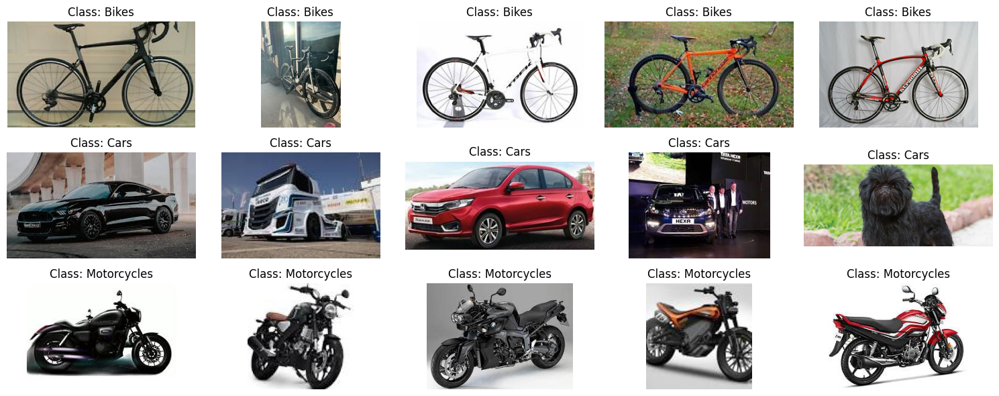

In [ ]:
import matplotlib.pyplot as plt

df = dataset_hf.to_pandas()
df_group = df.groupby("label").apply(lambda x: x.sample(5))
ids = df_group.index.get_level_values(1)

def get_image_and_label(idx):
    return dataset_hf[idx]["image"], dataset_hf[idx]["label"]

images_by_class = {}
for idx in ids:
    image, label = get_image_and_label(idx)
    if label not in images_by_class:
        images_by_class[label] = []
    images_by_class[label].append(image)

class_labels = list(images_by_class.keys())
images_class_1 = images_by_class[class_labels[0]]
images_class_2 = images_by_class[class_labels[1]]
images_class_3 = images_by_class[class_labels[2]]

fig, axes = plt.subplots(3, 5, figsize=(15, 6))

for i, ax in enumerate(axes[0]):
    ax.imshow(images_class_1[i])
    ax.set_title(f"Class: {dataset_hf.features['label'].int2str(class_labels[0])}")
    ax.axis("off")

for i, ax in enumerate(axes[1]):
    ax.imshow(images_class_2[i])
    ax.set_title(f"Class: {dataset_hf.features['label'].int2str(class_labels[1])}")
    ax.axis("off")

for i, ax in enumerate(axes[2]):
    ax.imshow(images_class_3[i])
    ax.set_title(f"Class: {dataset_hf.features['label'].int2str(class_labels[2])}")
    ax.axis("off")

plt.tight_layout()
plt.show()


## Загрузка предсказаний и эмбеддингов


Строго говоря, `Datalab` не трубет обязательного наличия двух сущностей в виде предсказаний и эмбеддингов, но может обнаруживать больше проблем. Также на качество влияет и качество этих сущностей, чем лучше модели с помощью которых они получены тем лучше обнаружение.

In [ ]:
from pathlib import Path

if not Path("/content/features.npy").exists():
    !wget -qnc  https://ml.gan4x4.ru/wb/cv/datasets/eda_image/features.npy
else:
    print("features already downloaded")

if not Path("/content/pred_probs.npy").exists():
    !wget -qnc  https://ml.gan4x4.ru/wb/cv/datasets/eda_image/pred_probs.npy
else:
    print("pred_probs already downloaded")

In [ ]:
features = np.load("features.npy")
pred_probs = np.load("pred_probs.npy")

## Используем Datalab для обнаружения проблем в датасете


Создадим объект Datalab и используем метод `find_issues` для обнаружения проблем

In [ ]:
lab = Datalab(data=dataset_hf, label_name='label')
lab.find_issues(features=features, pred_probs=pred_probs)

Finding null issues ...
Finding label issues ...
Finding outlier issues ...
Finding near_duplicate issues ...
Finding non_iid issues ...
Finding class_imbalance issues ...
Finding underperforming_group issues ...

Audit complete. 338 issues found in the dataset.


После аудита мы видим количество проблемных объектов в датасете. На самом деле, это не значит, что все эти объекты с проблемные, но из всех прочих они самые подозрительные. Теперь мы можем не просматривать весь датасет, а оценить только отмеченные объекты, что значительно ускоряет и упрощает процесс чистки датасета.

Посмотрим более подробный отчет:

In [ ]:
lab.report(include_description=False)

Dataset Information: num_examples: 2489, num_classes: 3

Here is a summary of various issues found in your data:

    issue_type  num_issues
       outlier         201
near_duplicate          85
         label          51
       non_iid           1

Learn about each issue: https://docs.cleanlab.ai/stable/cleanlab/datalab/guide/issue_type_description.html
See which examples in your dataset exhibit each issue via: `datalab.get_issues(<ISSUE_NAME>)`

Data indices corresponding to top examples of each issue are shown below.


---------------------- outlier issues ----------------------

Number of examples with this issue: 201
Overall dataset quality in terms of this issue: 0.4071

Examples representing most severe instances of this issue:
      is_outlier_issue  outlier_score
915               True       0.000149
1344              True       0.000233
1323              True       0.000535
1043              True       0.000774
1137              True       0.000804


------------------ near_d

Или можем вывести количество объектов по каждому типу проблем:

In [ ]:
lab.get_issue_summary()

,issue_type,score,num_issues
0,null,1.000000,0
1,label,0.981117,51
2,outlier,0.407092,201
3,near_duplicate,0.594417,85
4,non_iid,0.000000,1
5,class_imbalance,0.327843,0
6,underperforming_group,0.538224,0



Определим дополнительную функцию  `make_image_plot` для визуализации:

In [ ]:
def make_image_plot(ax, img, label=None, additional_info=None):
    title = ""
    if label is not None:
        title = "Label {}".format(label)

    if additional_info is not None:
        title += "\n" + additional_info

    if title:
        ax.set_title(title)
    ax.axis("off")
    ax.imshow(img, cmap="gray")

## Визуализация проблемных объектов


Остальная часть этого ноутбука будет посвящена визуализации различных типов проблем, обнаруженных в датасете.

Общий порядок такой:

1. DataFrame с индексами объектов и оценкой "проблемности"
2. Сортировка объектов по оценке

3. Изучение отсортированных результатов и создание графиков изображений с различной соответствующей информацией или контекстом.

### Дубликаты


В этом разделе мы посмотрим примеры из датасета, которые считаются дубликатами.

DataFrame `near_duplicate_issues` показывает, какие примеры считаются имеющими дубликаты, и мы можем отсортировать их по `near_duplicate_score`, который оценивает, насколько серьезной является эта проблема для каждого изображения (меньшие значения указывают на более серьезные случаи).

In [ ]:
near_duplicate_issues = lab.get_issues("near_duplicate")

near_duplicate_df = near_duplicate_issues.query("is_near_duplicate_issue").sort_values(
    "near_duplicate_score", ascending=True
)

near_duplicate_df

,is_near_duplicate_issue,near_duplicate_score,near_duplicate_sets,distance_to_nearest_neighbor
7,True,0.000000,[164],0.000000
1533,True,0.000000,[1293],0.000000
1529,True,0.000000,[1170],0.000000
1508,True,0.000000,[1324],0.000000
1452,True,0.000000,[1640],0.000000
...,...,...,...,...
58,True,0.089990,[659],0.002732
484,True,0.119525,[704],0.003688
704,True,0.119525,[484],0.003688
613,True,0.121670,[78],0.003758




Определим функцию `plot_near_duplicate_images`, которая принимает строку из DataFrame `near_duplicate_issues` в качестве входных данных. Эта функция:

1. Извлекает оригинальное изображение и его метку на основе индекса строки.

2. Создает подграфик для оригинального изображения и каждого из его дубликатов.


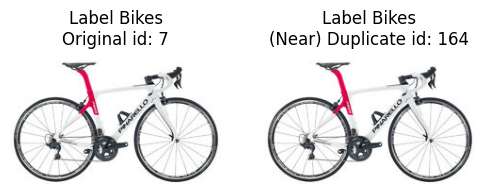

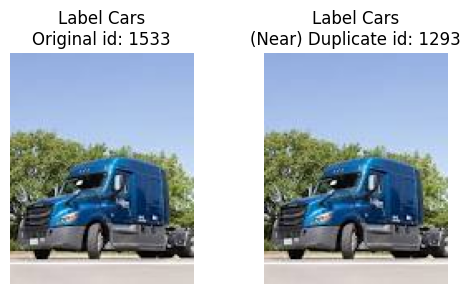

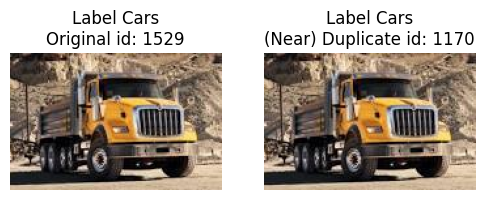

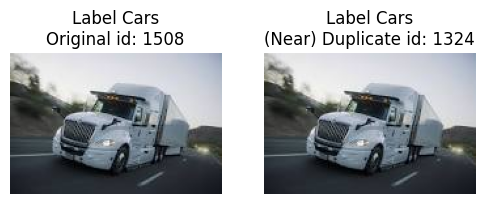

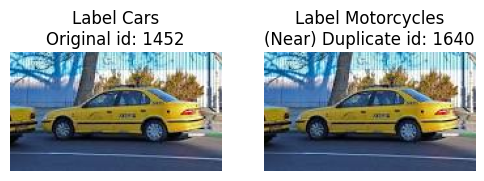

...

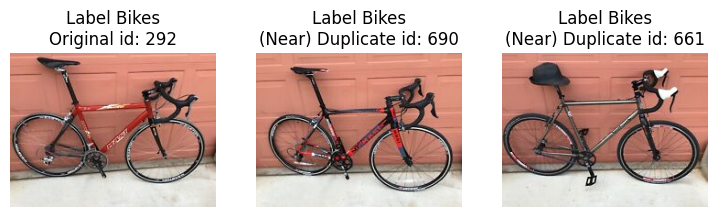

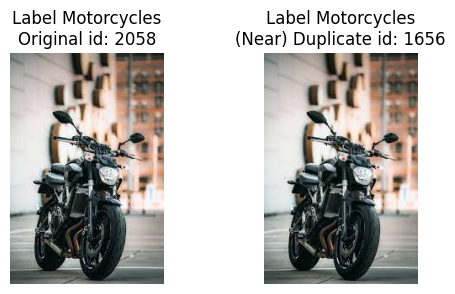

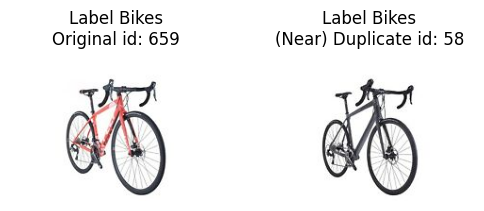

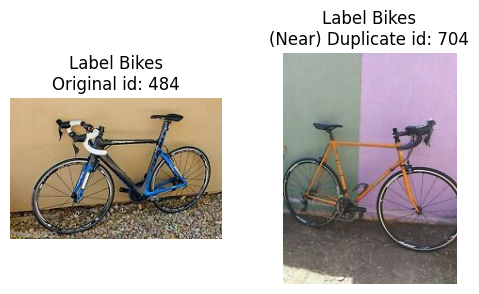

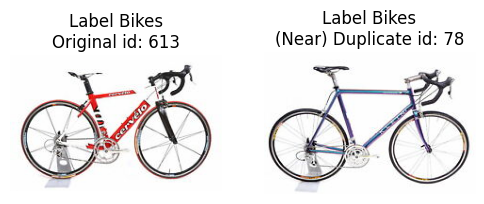

In [ ]:
seen_ids = set()


def plot_near_duplicate_images(row):
    label_issues = lab.get_issues("label")

    def get_image_and_given_label(idx):
        image = dataset_hf[idx]["image"]
        label = label_issues.loc[idx]["given_label"]
        return image, label

    img1_idx = row.name
    if img1_idx in seen_ids:
        return

    duplicate_images = row.near_duplicate_sets
    # how many near duplicates have we seen so far?
    seen_near_duplicates = seen_ids.intersection(duplicate_images)
    # if we have seen all near duplicates, we can skip the rest
    if len(seen_near_duplicates) == len(duplicate_images):
        return

    # If the set has more than 5 near duplicates, at least half of them should be new
    if (
        len(duplicate_images) > 5
        and len(seen_near_duplicates) > len(duplicate_images) / 2
    ):
        return

    num_figures = len(duplicate_images) + 1
    _, ax = plt.subplots(1, num_figures, figsize=(num_figures * 3, 3))
    original_image, label = get_image_and_given_label(img1_idx)
    make_image_plot(
        ax[0], original_image, label, additional_info=f"Original id: {img1_idx}"
    )

    seen_ids.add(img1_idx)

    for i, duplicate_image in enumerate(duplicate_images):
        img2_idx = int(duplicate_image)
        if True:
            img2, label2 = get_image_and_given_label(img2_idx)
            is_near_duplicate = near_duplicate_issues.loc[img2_idx][
                "is_near_duplicate_issue"
            ]
            additional_info = ""
            if is_near_duplicate:
                additional_info = f"(Near) Duplicate id: {img2_idx}"
            make_image_plot(ax[i + 1], img2, label2, additional_info=additional_info)
            seen_ids.add(img2_idx)


near_duplicate_df.apply(plot_near_duplicate_images, axis=1)
plt.show()

### Ошибки в разметке

Визуализиурем объекты с ошибками в разметке


In [ ]:
label_issues = lab.get_issues("label")

labels_df = label_issues.query("is_label_issue").sort_values(
    "label_score", ascending=True
)
labels_df.head(10)

,is_label_issue,label_score,given_label,predicted_label
803,True,1.275827e-38,Bikes,Motorcycles
2427,True,2.557642e-32,Motorcycles,Bikes
1639,True,3.294582e-31,Motorcycles,Cars
2437,True,1.283022e-29,Motorcycles,Bikes
2434,True,8.938321e-26,Motorcycles,Bikes
2429,True,2.048185e-21,Motorcycles,Bikes
802,True,2.989866e-18,Bikes,Motorcycles
2431,True,2.328689e-17,Motorcycles,Bikes
1640,True,3.038439e-14,Motorcycles,Cars
2435,True,3.751761e-12,Motorcycles,Bikes


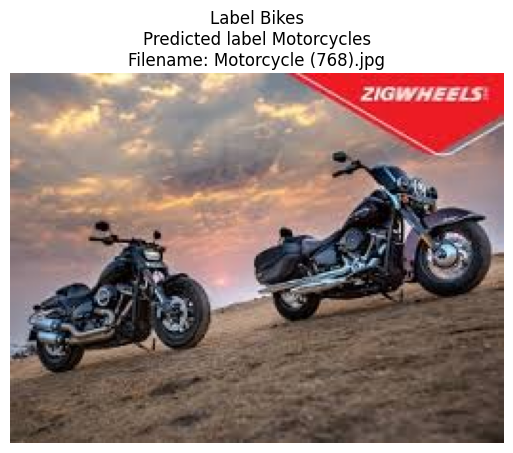

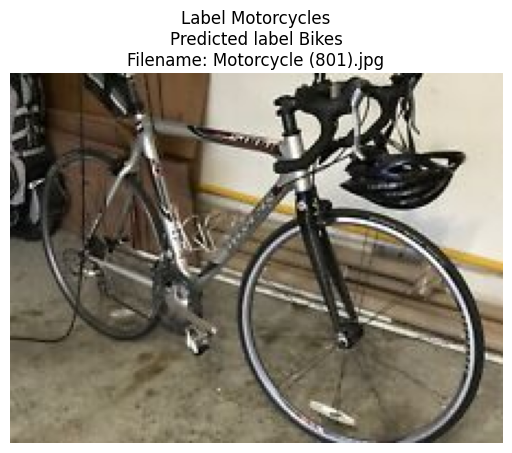

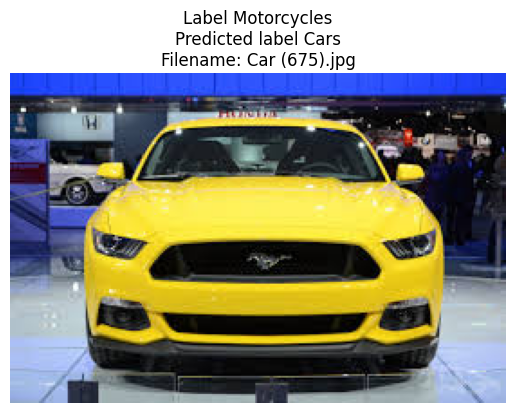

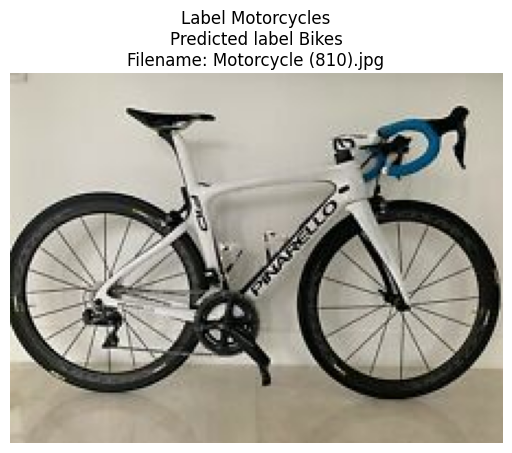

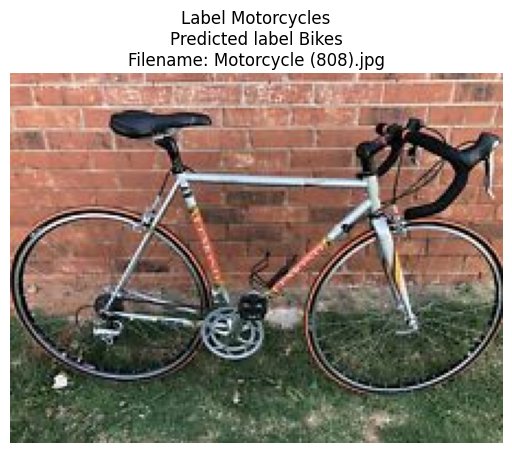

...

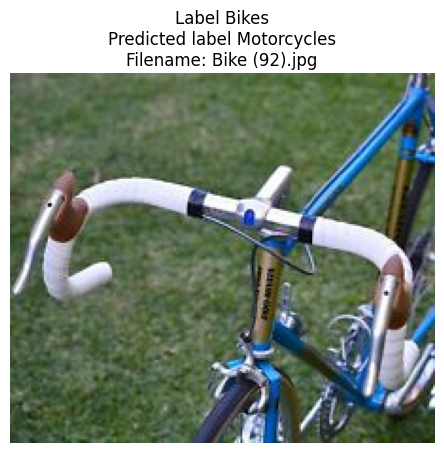

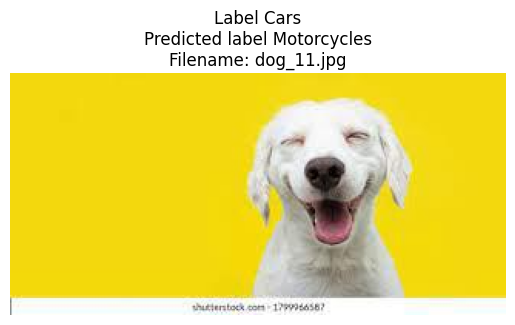

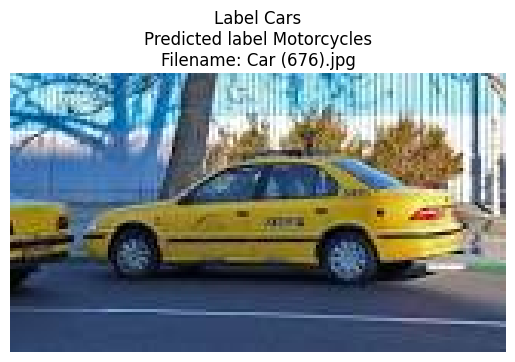

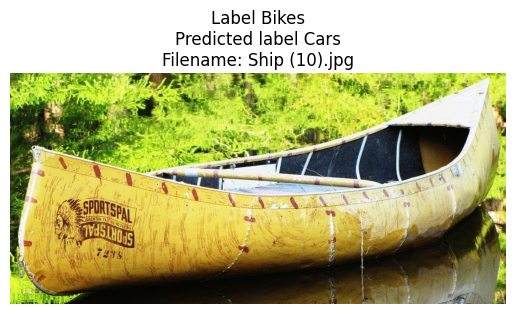

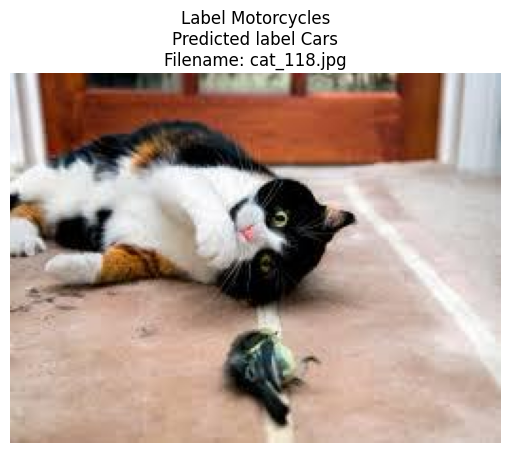

In [ ]:
def plot_label_issues(row):
    idx = row.name
    image = dataset_hf[idx]["image"]
    image_filename = image.filename.split("/")[-1]
    label = label_issues.loc[idx]["given_label"]
    predicted_label = label_issues.loc[idx]["predicted_label"]

    filename_label = image_filename.split("_")[0]
    ax = plt.subplot(1, 1, 1)
    additional_info = f"Predicted label {predicted_label}"
    if label.split(".")[0] != filename_label:
        additional_info += f"\nFilename: {image_filename}"

    make_image_plot(ax, image, label, additional_info=additional_info)
    plt.show()


labels_df.apply(plot_label_issues, axis=1)
plt.show()

### Выбросы

Чаще всего это когда в датасете для определенного класса присутствуют изображения вообще не относящиеся к данному классу или сильно отличаются. В нашем случае в классе автомобили присутствуют грузовики, иногда для нас это норма, а иногда мы хотели бы их разделять.

In [ ]:
outlier_issues = lab.get_issues("outlier")

outliers_df = outlier_issues.query("is_outlier_issue").sort_values(
    "outlier_score", ascending=True
)
outliers_df.head(10)

,is_outlier_issue,outlier_score
915,True,0.000149
1344,True,0.000233
1323,True,0.000535
1043,True,0.000774
1137,True,0.000804
912,True,0.001423
865,True,0.001534
1045,True,0.001698
1592,True,0.001722
1317,True,0.001797


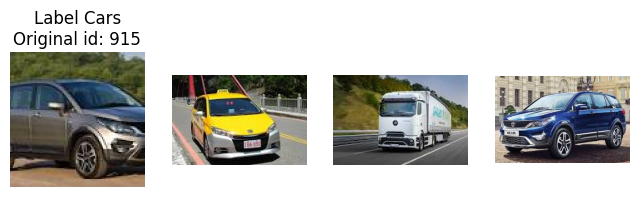

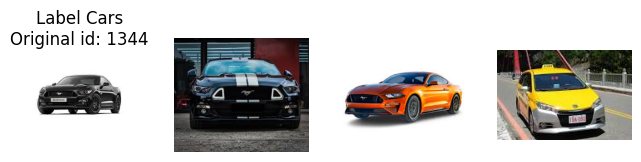

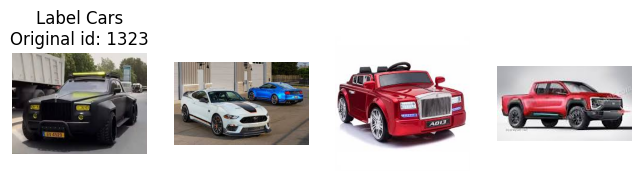

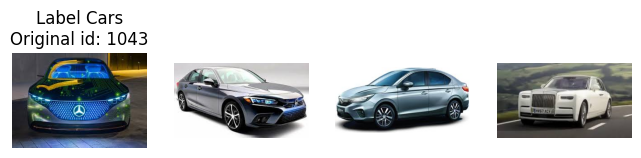

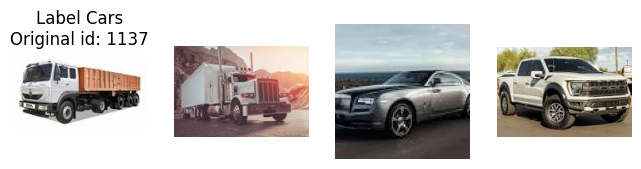

...

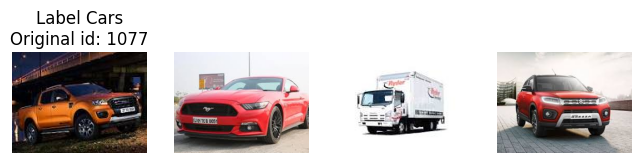

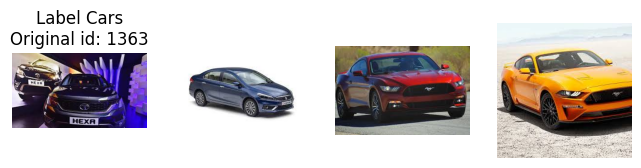

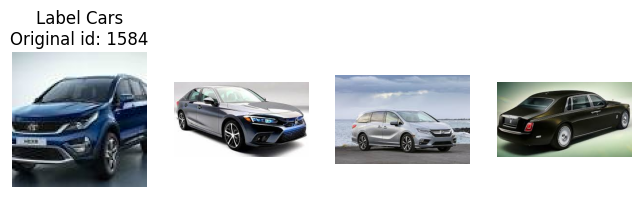

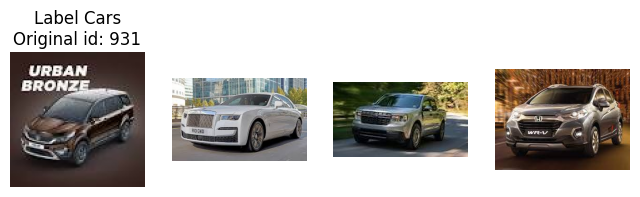

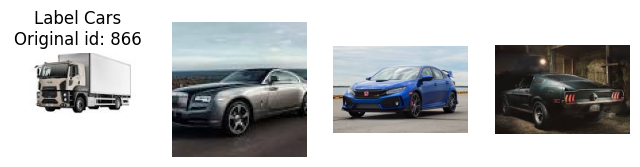

In [ ]:
def plot_outlier_issues(row):
    label_issues = lab.get_issues("label")
    N_comparison_images = 3

    def sample_from_class(label, number_of_samples, index):
        index = int(index)

        non_outlier_indices = (
            label_issues.join(outlier_issues)
            .query("given_label == @label and not is_outlier_issue")
            .index
        )
        non_outlier_indices_excluding_current = non_outlier_indices[
            non_outlier_indices != index
        ]

        sampled_indices = np.random.choice(
            non_outlier_indices_excluding_current, number_of_samples, replace=False
        )

        label_scores_of_sampled = label_issues.loc[sampled_indices]["label_score"]

        top_score_indices = np.argsort(label_scores_of_sampled.values)[::-1][
            :N_comparison_images
        ]

        top_label_indices = sampled_indices[top_score_indices]

        sampled_images = [dataset_hf[int(i)]["image"] for i in top_label_indices]

        return sampled_images

    def get_image_given_label_and_samples(idx):
        image_from_dataset = dataset_hf[idx]["image"]
        corresponding_label = label_issues.loc[idx]["given_label"]
        comparison_images = sample_from_class(corresponding_label, 30, idx)[
            :N_comparison_images
        ]

        return image_from_dataset, corresponding_label, comparison_images

    idx = row.name
    image, label, comparison_images = get_image_given_label_and_samples(idx)
    _, ax = plt.subplots(1, N_comparison_images + 1, figsize=(8, 5))

    make_image_plot(ax[0], image, label, additional_info=f"Original id: {idx}")
    for i, comparison_image in enumerate(comparison_images):
        make_image_plot(ax[i + 1], comparison_image)
    plt.show()


outliers_df.apply(plot_outlier_issues, axis=1)
plt.show()

### Дубликаты и ошибка в разметке
Визуализируем объекты, которые являются дубликатами, но при этом еще имееют разные метки.

In [ ]:
label_issues, near_duplicate_issues = (
    lab.get_issues(name) for name in ["label", "near_duplicate"]
)

# query_expr = "is_label_issue and is_near_duplicate_issue"
query_expr = "given_label != predicted_label and is_near_duplicate_issue"  # Use disagreement instead of is_label_issue
near_duplicate_labels_df = (
    label_issues.join(near_duplicate_issues, how="outer")
    .query(query_expr)
    .sort_values("label_score", ascending=True)
)
near_duplicate_labels_df.head(10)

,is_label_issue,label_score,given_label,predicted_label,is_near_duplicate_issue,near_duplicate_score,near_duplicate_sets,distance_to_nearest_neighbor
803,True,1.275827e-38,Bikes,Motorcycles,True,0.0,[2389],0.0
1639,True,3.294582e-31,Motorcycles,Cars,True,0.0,[1451],0.0
802,True,2.989866e-18,Bikes,Motorcycles,True,0.0,[2388],0.0
1640,True,3.038439e-14,Motorcycles,Cars,True,0.0,[1452],0.0
800,True,3.086835e-10,Bikes,Motorcycles,True,0.0,[2386],0.0
801,True,2.554889e-08,Bikes,Motorcycles,True,0.0,[2387],0.0
1635,True,4.496071e-07,Motorcycles,Cars,True,0.0,[1447],0.0
1637,True,2.804128e-06,Motorcycles,Cars,True,0.0,[1449],0.0
1638,True,1.032509e-05,Motorcycles,Cars,True,0.0,[1450],0.0
1636,True,8.722235e-05,Motorcycles,Cars,True,0.0,[1448],0.0


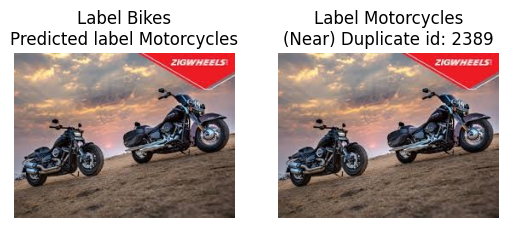

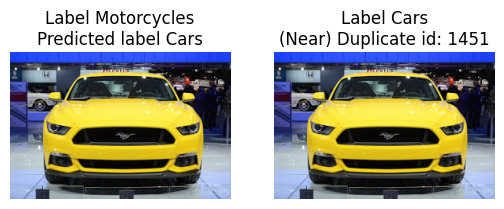

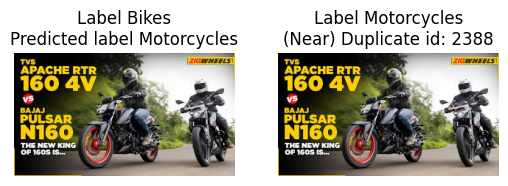

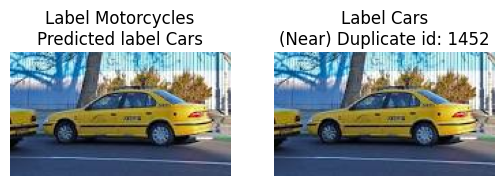

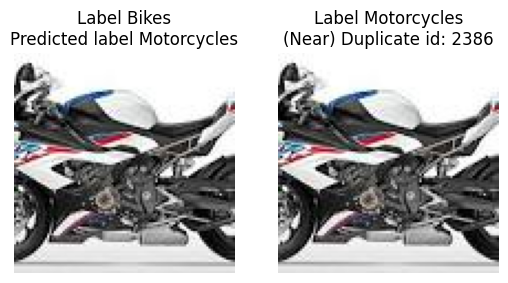

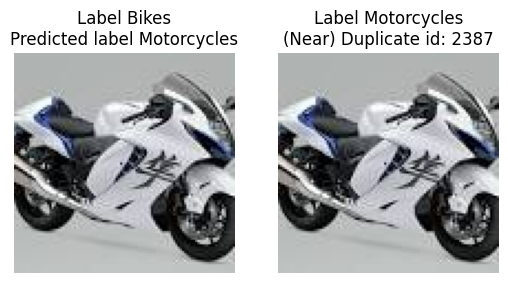

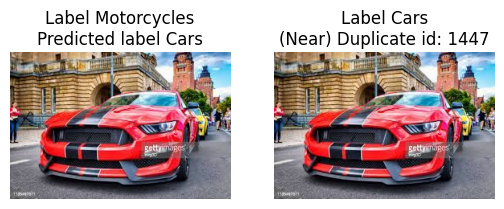

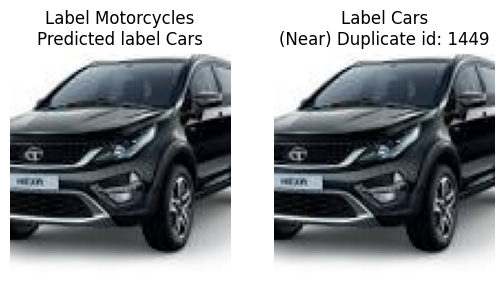

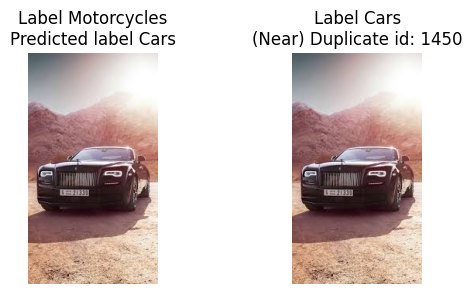

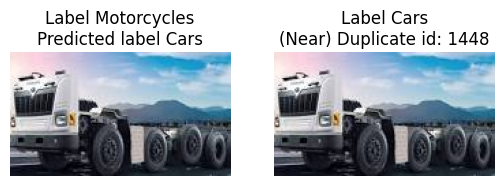

In [ ]:
seen_id_pairs = set()


def plot_label_and_near_duplicate_issues(row):
    def get_image_and_given_label_and_predicted_label(idx):
        image = dataset_hf[idx]["image"]
        label = label_issues.loc[idx]["given_label"]
        predicted_label = label_issues.loc[idx]["predicted_label"]
        return image, label, predicted_label

    idx = row.name
    image, label, predicted_label = get_image_and_given_label_and_predicted_label(idx)
    duplicate_images = row.near_duplicate_sets

    id_collection = tuple(sorted([idx] + list(duplicate_images)))
    if id_collection in seen_id_pairs:
        return
    _, ax = plt.subplots(
        1, len(duplicate_images) + 1, figsize=((len(duplicate_images) + 1.5) ** 2, 3)
    )
    make_image_plot(
        ax[0], image, label, additional_info=f"Predicted label {predicted_label}"
    )
    for i, duplicate_image in enumerate(duplicate_images):
        img2, label2, predicted_label2 = get_image_and_given_label_and_predicted_label(
            int(duplicate_image)
        )
        if (idx, duplicate_image) in seen_id_pairs or (
            duplicate_image,
            idx,
        ) in seen_id_pairs:
            continue
        seen_id_pairs.add((idx, duplicate_image))
        make_image_plot(
            ax[i + 1],
            img2,
            label2,
            additional_info=f"(Near) Duplicate id: {duplicate_image}",
        )
    seen_id_pairs.add(id_collection)


near_duplicate_labels_df.apply(plot_label_and_near_duplicate_issues, axis=1)
plt.show()

## Оценка качества изображений


Изображения которые являются: темными, светлыми, размытыми, с низким содержанием информации, с необычным соотношением сторон, с необычным размером, черно-белыми и т.д.

Подробнее [cleanvision](https://github.com/cleanlab/cleanvision)

In [ ]:
!pip -q install "cleanlab[image]"

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.5/51.5 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.9/55.9 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.7/296.7 kB 9.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 39.8 MB/s eta 0:00:00


In [ ]:
dataset_hf.features

{'image': Image(mode=None, decode=True, id=None),
 'label': ClassLabel(names=['Bikes', 'Cars', 'Motorcycles'], id=None)}

In [ ]:
lab = Datalab(data=dataset_hf, label_name="label", image_key="image")
lab.find_issues(features=features, pred_probs=pred_probs)

Finding null issues ...
Finding label issues ...
Finding outlier issues ...
Finding near_duplicate issues ...
Finding non_iid issues ...
Finding class_imbalance issues ...
Finding underperforming_group issues ...
Finding dark, light, low_information, odd_aspect_ratio, odd_size, grayscale, blurry images ...


  0%|          | 0/2489 [00:00<?, ?it/s]

Finding spurious correlation issues in the dataset ...

Audit complete. 460 issues found in the dataset.


Dataset Information: num_examples: 2489, num_classes: 3

Here is a summary of various issues found in your data:

      issue_type  num_issues
         outlier         201
        odd_size         114
  near_duplicate          85
           label          51
odd_aspect_ratio           8
         non_iid           1

Learn about each issue: https://docs.cleanlab.ai/stable/cleanlab/datalab/guide/issue_type_description.html
See which examples in your dataset exhibit each issue via: `datalab.get_issues(<ISSUE_NAME>)`

Data indices corresponding to top examples of each issue are shown below.


---------------------- outlier issues ----------------------

Number of examples with this issue: 201
Overall dataset quality in terms of this issue: 0.4071

Examples representing most severe instances of this issue:
      is_outlier_issue  outlier_score
915               True       0.000149
1344              True       0.000233
1323              True       0.000535
1043              True       0.0007

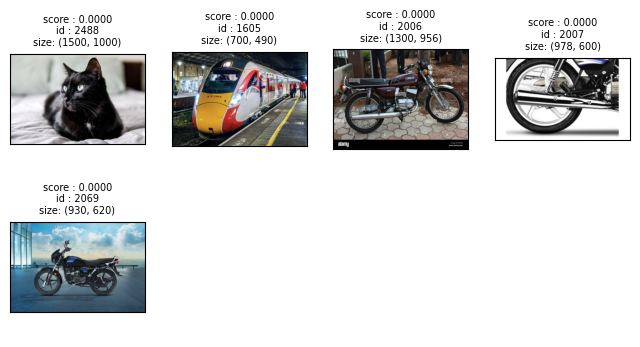

----------------- odd_aspect_ratio images ------------------

Number of examples with this issue: 8
Examples representing most severe instances of this issue:



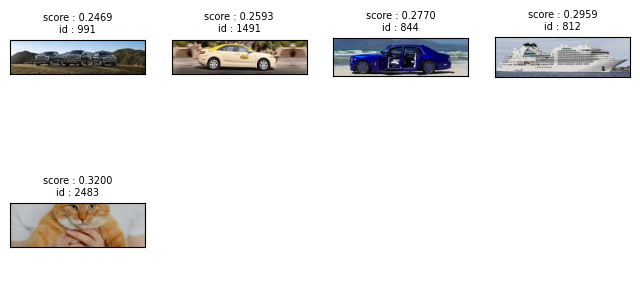

In [ ]:
lab.report(include_description=False)


Подобно вышеупомянутым типам проблем, мы можем отфильтровать DataFrame `odd_aspect_ratio_df`, чтобы найти примеры, которые считаются имеющими необычное соотношение сторон. Затем мы сортируем отфильтрованные результаты по их `odd_aspect_ratio_score` в порядке возрастания, где примеры с наименьшими оценками имеют необычные соотношения сторон.

In [ ]:
odd_aspect_ratio_df = lab.get_issues("odd_aspect_ratio")
odd_aspect_ratio_df = odd_aspect_ratio_df.query(
    "is_odd_aspect_ratio_issue"
).sort_values("odd_aspect_ratio_score", ascending=True)
odd_aspect_ratio_df

,odd_aspect_ratio_score,is_odd_aspect_ratio_issue
991,0.246914,True
1491,0.259259,True
844,0.276995,True
812,0.295936,True
2483,0.320000,True
1025,0.320707,True
1035,0.320988,True
183,0.333333,True




Как и в случае с вышеупомянутыми типами проблем, ключ `image_issue_types` может быть использован для проверки конкретных проблем с изображениями. Пример ниже показывает, как проверить изображения с необычным соотношением сторон.

Обратите внимание, что проверка на специфические проблемы с изображениями не зависит от столбца `label`, `pred_probs` или `features`. Для этого требуются только исходные изображения `PIL` и `image_key`.

In [ ]:
lab = Datalab(data=dataset_hf, image_key="image")
lab.find_issues(issue_types={"image_issue_types": {"odd_aspect_ratio": {}}})

Finding odd_aspect_ratio images ...


  0%|          | 0/2489 [00:00<?, ?it/s]


Audit complete. 8 issues found in the dataset.


Dataset Information: num_examples: 2489

Here is a summary of various issues found in your data:

      issue_type  num_issues
odd_aspect_ratio           8

Learn about each issue: https://docs.cleanlab.ai/stable/cleanlab/datalab/guide/issue_type_description.html
See which examples in your dataset exhibit each issue via: `datalab.get_issues(<ISSUE_NAME>)`

Data indices corresponding to top examples of each issue are shown below.






----------------- odd_aspect_ratio images ------------------

Number of examples with this issue: 8
Examples representing most severe instances of this issue:



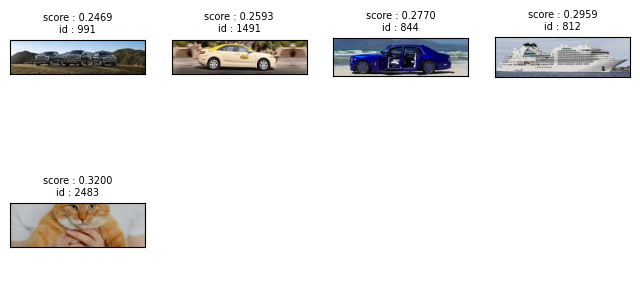

In [ ]:
lab.report()



Можем указать нестандартные значения гиперпараметров для использования при обнаружении этой проблемы.

Например, проблема `odd_aspect_ratio` имеет гиперпараметр `threshold`, при котором изображения с оценкой качества ниже этого порога помечаются как имеющие эту проблему. Изменяя его значение, мы можем обеспечить, чтобы большее или меньшее количество изображений помечалось как имеющее `odd_aspect_ratio`.

In [ ]:
lab.find_issues(
    issue_types={"image_issue_types": {"odd_aspect_ratio": {"threshold": 0.5}}}
)
lab.report()

Finding odd_aspect_ratio images ...

Audit complete. 0 issues found in the dataset.
No issues found in the data. Good job!

Try re-running Datalab.report() with `show_summary_score = True` and `show_all_issues = True`.



